# Bus Ridership Project
By Qi Si, Jiamin Tan, Xuezhu (Gillian) Zhao

Final Project - MUSA 550 Geospatial Data Science in Python

## Introduction
CTA has 1,864 buses that make about 19,237 trips a day and serve 10,768 bus stops, according to the latest official tally in 2017. However, there is not much publicly available information on how the bus service has been used. What are the areas with lots of ridership? Are there any interesting spatial patterns? Are there areas with potential ridership demand, but are not accessible to a bus stop?

Through our project, we hope to gain a better understanding of the bus ridership service and usage and apply our insights to improve planning of bus stations. We will find boarding and alighting patterns across geographies and sociodemographics to select indicators of ridership demand. From there, we will build a prediction model to help predict ridership demand across the city. Finally, we will visualize a dashboard to help city officials identify areas in need of better bus services.

## Preparation

### Library import

In [1]:
# data processing
import pandas as pd
import geopandas as gpd
import numpy as np
import carto2gpd
import esri2gpd

# basic graphics
from matplotlib import pyplot as plt
import holoviews as hv
import hvplot.pandas
import altair as alt
import folium
import seaborn as sns
import matplotlib.colors as mcolors

# advanced graphics
import panel as pn
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
import param
import folium as fm

# census
import cenpy

# osm
import osmnx as ox

# bus ridership data
from sodapy import Socrata

# analysis
import math as mt
##!pip install kneed
from kneed import KneeLocator
## sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors

# shapely
from shapely.geometry import Polygon, LineString, Point

# regressoin
from sklearn.model_selection import train_test_split

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor

from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

# od analysis- dask:
import dask.array as da
import dask.dataframe as dd
from colorcet import fire
import geoviews as gv
import geoviews.tile_sources as gvts


import pandas as pd

### Data preparation - Chicago

#### Ridership data

In [2]:
# get the bus ridership data from API
client = Socrata("data.cityofchicago.org", None)
results = client.get("mq3i-nnqe", limit=11593) # length of data shown on their website

bus_ridership_df = pd.DataFrame.from_records(results)

# add geometry
bus_ridership_lat = [row['latitude'] for row in bus_ridership_df['location']]
bus_ridership_lat_df = pd.DataFrame(np.column_stack([bus_ridership_lat]))
bus_ridership_lon = [row['longitude'] for row in bus_ridership_df['location']]
bus_ridership_lon_df = pd.DataFrame(np.column_stack([bus_ridership_lon]))

bus_ridership_df['latitude'] = bus_ridership_lat_df
bus_ridership_df['longitude'] = bus_ridership_lon_df

bus_ridership_gdf = gpd.GeoDataFrame(
    bus_ridership_df, geometry=gpd.points_from_xy(x=bus_ridership_df.longitude, y=bus_ridership_df.latitude)
)

# create a gdf for bus stop data
bus_data = bus_ridership_gdf[['stop_id', 'on_street', 'cross_street', 'routes', 'boardings', 'alightings', 'geometry']]

# set the crs of bus stops to epsg:3857
bus_data.crs = "EPSG:4326"
bus_data = bus_data.to_crs("epsg:3857")

#### Socioeconomic data

##### Data from Census

In [3]:
# make cenpy api connection
acs = cenpy.remote.APIConnection("ACSDT5Y2019")

# get block group gemetry from census data
# set geo server
acs.set_mapservice("tigerWMS_ACS2019")

# Use SQL to return geometries only for Cook County, IL
where_clause = f"STATE = {'17'} AND COUNTY = {'031'}"

# Query for block groups
cook_bg = acs.mapservice.layers[10].query(where=where_clause)

# calculate the total area of each block group
cook_bg["TOTALAREA"] = cook_bg.area

# import Chicago city limit
city_boundary_gdf = gpd.read_file("https://data.cityofchicago.org/resource/qqq8-j68g.geojson").to_crs('epsg:3857')

# get blcok groups within Chicaco
joined = gpd.sjoin(cook_bg, city_boundary_gdf, op='intersects', how="inner") 

# there is a huge block group in the Michigan Lake, find out it's GEOID by sorting the total area
cook_bg.sort_values(by = "TOTALAREA", ascending = False).head(1)['GEOID']

# remove it from the dataset
joined = joined[joined["GEOID"] != "170319900000"]

# we only need the geometry and GEOID for the block groups
chicago_bg = joined[['GEOID', 'geometry']]

# listing socioeconomics variables from 2019 5-year acs 
variables = [
    "NAME",
    "B01003_001E", # total pop
    "B25064_001E", # median rent
    "B19113_001E", # median income
    "B01002_001E", # median age
    "B15003_001E", # educational attainment for the pop 25 and over 
    "B15003_022E", # total bachelor's degree
    "B15003_023E", # master's degree                    
    "B15003_025E", # doctoral
    "B02001_002E", # white
    "B25003_001E", # tenure: total
    "B25003_002E", # tenure: owner
    "B08134_001E", # total commuters
    "B08134_061E", # commute by public transp
    "GEO_ID"
]

# query from the cenpy api
cook_data = acs.query(
    cols=variables,
    geo_unit="block group:*",
    geo_filter={"state": "17", 
                "county": "031", 
                "tract": "*"},
)

# rename the columns for easier references
dict = {"NAME": "NAME",
    "B01003_001E": "total_pop",
    "B25064_001E": "median_rent",
    "B19113_001E": "median_income",
    "B01002_001E": "median_age",
    "B15003_001E": "educational_attainment_pop25" ,
    "B15003_022E": "bachelor_degree",
    "B15003_023E": "master_degree"  ,                  
    "B15003_025E": "doctoral_degree",
    "B02001_002E": "white",
    "B25003_001E": "tenure_total",
    "B25003_002E": "tenure_owner",
    "B08134_001E": "commuter_total",
    "B08134_061E": "commuter_PuT",
    "GEO_ID": "GEO_ID"}

cook_data.rename(columns=dict, inplace=True)

# getting the GEOID for spatial join
cook_data["GEOID"] = [x[9:] for x in cook_data['GEO_ID']]

# merge the chicago block group gemoetry with socioeconomic variables by GEOID
chicago_data = chicago_bg.merge(cook_data, on = "GEOID") 

# converting strings to numeric input
for variable in chicago_data.columns:
    # Convert all variables
    if variable != "NAME" and variable != "GEO_ID" and variable != "geometry" and variable != "GEOID":
        chicago_data[variable] = chicago_data[variable].astype(float)
        
# spatial join the boarding and alighting from bus stop data
chicago_bg = gpd.sjoin(chicago_bg, bus_data, how = "left")

chicago_bg = chicago_bg[["GEOID", "boardings", "alightings"]]

# converting strings to numeric input
for variable in chicago_bg.columns:
    if variable != "GEOID":
    # Convert all variables
        chicago_bg[variable] = chicago_bg[variable].astype(float)

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\pyproj\crs\crs.py:68: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


##### Stop-level Ridership data to Block-group level data

In [4]:
# find the average abordings and alightings in each chicago block group
bus_bg = chicago_bg.groupby("GEOID")[["boardings", "alightings"]].mean()

# change all NaN value to 0 and round all boardings and alightings to integers
bus_bg = bus_bg.replace(np.nan, 0).round(0)

# merge the socioeconomics data with bus stop data
chicago_data = chicago_data.merge(bus_bg, on = "GEOID")

##### Data cleaning

In [5]:
# data cleanning: replace error values with average values. 
## median rent: replace -666666666.0 in median rent with average. median rent of all tract.
chicago_data['median_rent'] = chicago_data['median_rent'].replace([-666666666.0],np.nan)
mean = chicago_data['median_rent'].mean()
chicago_data.loc[:,'median_rent'] = chicago_data.loc[:,'median_rent'].fillna(mean)

## median income: replace -666666666.0 with mean 
chicago_data['median_income'] = chicago_data['median_income'].replace([-666666666.0],np.nan)
mean = chicago_data['median_income'].mean()
chicago_data.loc[:,'median_income'] = chicago_data.loc[:,'median_income'].fillna(mean)

## median age: 
chicago_data['median_age'] = chicago_data['median_age'].replace([-666666666.0],np.nan)
mean = chicago_data['median_age'].mean()
chicago_data.loc[:,'median_age'] = chicago_data.loc[:,'median_age'].fillna(mean)

## commuter_total:
chicago_data['commuter_PuT'] = chicago_data['commuter_PuT'].replace(np.nan, chicago_data['commuter_PuT'].mean())

# percent of people who have college degree or above
chicago_data["pct_college_degree"] = (chicago_data["bachelor_degree"] + chicago_data["master_degree"] + chicago_data["doctoral_degree"]) / chicago_data["educational_attainment_pop25"]
# replace nan with 0 since total can be 0
chicago_data["pct_college_degree"] = chicago_data["pct_college_degree"].replace(np.nan, 0)

# percent of racial minorities
chicago_data["pct_racial_minorities"] = 1 - chicago_data["white"] / chicago_data["total_pop"]
# replace nan with 0 since total can be 0
chicago_data["pct_racial_minorities"] = chicago_data["pct_racial_minorities"].replace(np.nan, 0)

# percent of property owner
chicago_data["pct_property_owner"] = chicago_data['tenure_owner'] / chicago_data['tenure_total']
# replace nan with 0 since total can be 0
chicago_data["pct_property_owner"] = chicago_data["pct_property_owner"].replace(np.nan, 0)

# percent of commuters using public transportation
chicago_data["pct_commuter_PuT"] = chicago_data['commuter_PuT'] / chicago_data['commuter_total']
# replace nan with 0 since total can be 0
chicago_data["pct_commuter_PuT"] = chicago_data["pct_commuter_PuT"].replace(np.nan, 0)

##### Feature Engineering

In [6]:
# load the city limit of Chicago
chicago_limit = gpd.read_file('data/Boundaries - City.geojson').set_crs("epsg:4326", allow_override=True,)
chicago_limit = chicago_limit.squeeze().geometry

In [7]:
# get the number of residential building in each block group from OSM data
residential = ox.geometries_from_polygon(
    chicago_limit, tags={"building": "residential"}
)

In [8]:
# get the number of office building in each block group from OSM data
office = ox.geometries_from_polygon(
    chicago_limit, tags={"building": "office"}
)

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


In [9]:
def get_xy_from_geometry(df):
    # NEW: use the centroid.x and centroid.y to support Polygon() and Point() geometries 
    x = df.geometry.centroid.x
    y = df.geometry.centroid.y
    
    return np.column_stack((x, y)) # stack as columns

In [10]:
# STEP 1: x/y coordinates of restaurants (in EPGS=3857)
resXY = get_xy_from_geometry(residential.to_crs(epsg=3857))

# STEP 2: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=10)

# STEP 3: Fit the algorithm on the "neighbors" dataset
nbrs.fit(resXY)

# STEP 4: Get distances for stations to neighbors
resDists, resIndices = nbrs.kneighbors(get_xy_from_geometry(chicago_data))

# STEP 5: add back to the original dataset
chicago_data['DistRes'] = resDists.mean(axis=1)

In [11]:
# STEP 1: x/y coordinates of restaurants (in EPGS=3857)
resXY = get_xy_from_geometry(office.to_crs(epsg=3857))

# STEP 2: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=10)

# STEP 3: Fit the algorithm on the "neighbors" dataset
nbrs.fit(resXY)

# STEP 4: Get distances for stations to neighbors
officeDists, officeIndices = nbrs.kneighbors(get_xy_from_geometry(chicago_data))

# STEP 5: add back to the original dataset
chicago_data['DistOffice'] = officeDists.mean(axis=1)

In [12]:
# import chicago CBD boundary
chicago_cbd_limit = gpd.read_file('data/Boundaries - City.geojson').set_crs("epsg:4326", allow_override=True,)

# get the centroid of the cbd polygon to represent cbd
chicago_cbd = chicago_cbd_limit.to_crs("epsg:3857").centroid

chicago_cbd = Point(chicago_cbd.x, chicago_cbd.y)

# get distance to cbd
chicago_data['dist_to_cbd'] = chicago_data.geometry.distance(chicago_cbd)

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


In [13]:
# chicago_data_filter: dataframe with only useful variables without geometry
# chicago_data_filter_GEOID: dataframe with only useful variables and GEOID without geometry
# filter the df with needed numeric data 
chicago_data_filter_GEOID = chicago_data.drop(columns=['NAME', 'state', 'county','block group','tract','geometry', 'GEO_ID', 
                                                'bachelor_degree', 'master_degree', 'doctoral_degree', 'educational_attainment_pop25', 'white', 'tenure_owner', 'tenure_total', 'commuter_PuT', 'commuter_total'])
chicago_data_filter = chicago_data.drop(columns=['NAME', 'state', 'county','block group','tract','geometry', 'GEO_ID', 'GEOID',
                                                'bachelor_degree', 'master_degree', 'doctoral_degree', 'educational_attainment_pop25', 'white', 'tenure_owner', 'tenure_total', 'commuter_PuT', 'commuter_total'])

In [14]:
# chicago_data_GEOID: geodataframe with GEOID and useful variables with geometry
# chicago_data: geodataframe with only useful variables with geometry
chicago_data_GEOID = chicago_data.drop(columns=['NAME', 'state', 'county','block group','tract', 'GEO_ID', 
                                                'bachelor_degree', 'master_degree', 'doctoral_degree', 'educational_attainment_pop25', 'white', 'tenure_owner', 'tenure_total', 'commuter_PuT', 'commuter_total'])
chicago_data = chicago_data.drop(columns=['NAME', 'state', 'county','block group','tract', 'GEO_ID', 'GEOID',
                                                'bachelor_degree', 'master_degree', 'doctoral_degree', 'educational_attainment_pop25', 'white', 'tenure_owner', 'tenure_total', 'commuter_PuT', 'commuter_total'])

##### Save chicago_data 
Chicago_data has block-group level census data, ridership data. 

Chicago_data_filter has block-group level census data, ridership data, no geometry

In [15]:
#chicago_data.to_file("data/chicago_data.geojson", driver='GeoJSON')
#chicago_data_GEOID.to_file("data/chicago_data_GEOID.geojson", driver='GeoJSON')
#chicago_data_filter.to_csv("data/chicago_data_filter.csv", index=False)
#chicago_data_filter_GEOID.to_csv("data/chicago_data_filter_GEOID.csv", index=False)

### Data preparation - Philadelphia

#### Bus stops data

In [16]:
# get the bus stop imformation from SEPTA GTFS file
philly_stops = pd.read_csv("data/stops.txt")

In [17]:
# create a geodatafram
philly_stops = gpd.GeoDataFrame(philly_stops, geometry=gpd.points_from_xy(philly_stops.stop_lon, philly_stops.stop_lat)).set_crs("epsg:4326")
# change crs to epsg:3857
philly_stops = philly_stops.to_crs("epsg:3857")

#### Socioeconomic data

##### Data from census

In [18]:
# get block group gemetry from census data
# set geo server
acs.set_mapservice("tigerWMS_ACS2019")

# Use SQL to return geometries only for Cook County, IL
where_clause = f"STATE = {'42'} AND COUNTY = {'101'}"

# Query for block groups
philly_bg = acs.mapservice.layers[10].query(where=where_clause)

# we only need the geometry and GEOID for the block groups
philly_bg = philly_bg[['GEOID', 'geometry']]

# listing socioeconomics variables from 2019 5-year acs 
variables = [
    "NAME",
    "B01003_001E", # total pop
    "B25064_001E", # median rent
    "B19113_001E", # median income
    "B01002_001E", # median age
    "B15003_001E", # educational attainment for the pop 25 and over 
    "B15003_022E", # total bachelor's degree
    "B15003_023E", # master's degree                    
    "B15003_025E", # doctoral
   
    "B02001_002E", # white
    
    "B25003_001E", # tenure: total
    "B25003_002E", # tenure: owner
    
    "B08134_001E", # total commuters
    "B08134_061E", # commute by public transp
    
    "GEO_ID"
]

# query from the cenpy api
philly_data = acs.query(
    cols=variables,
    geo_unit="block group:*",
    geo_filter={"state": "42", 
                "county": "101", 
                "tract": "*"},
)

# rename the columns for easier references
dict = {"NAME": "NAME",
    "B01003_001E": "total_pop",
    "B25064_001E": "median_rent",
    "B19113_001E": "median_income",
    "B01002_001E": "median_age",
    "B15003_001E": "educational_attainment_pop25" ,
    "B15003_022E": "bachelor_degree",
    "B15003_023E": "master_degree"  ,                  
    "B15003_025E": "doctoral_degree",
    "B02001_002E": "white",
    "B25003_001E": "tenure_total",
    "B25003_002E": "tenure_owner",
    "B08134_001E": "commuter_total",
    "B08134_061E": "commuter_PuT",
    "GEO_ID": "GEO_ID"}

philly_data.rename(columns=dict, inplace=True)

# getting the GEOID for spatial join
philly_data["GEOID"] = [x[9:] for x in philly_data['GEO_ID']]

# merge the philly block group gemoetry with socioeconomic variables by GEOID
philly_data = philly_bg.merge(philly_data, on = "GEOID") 

# converting strings to numeric input
for variable in philly_data.columns:
    
    # Convert all variables
    if variable != "NAME" and variable != "GEO_ID" and variable != "geometry" and variable != "GEOID":
        philly_data[variable] = philly_data[variable].astype(float)

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\pandas\core\dtypes\cast.py:1990: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  result[:] = values
C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\pyproj\crs\crs.py:68: FutureWarning: '+init=<authority>:<code>' synt

##### Data Cleaning

In [19]:
# data cleanning: replace error values with average values. 
## median rent: replace -666666666.0 in median rent with average. median rent of all tract.
philly_data['median_rent'] = philly_data['median_rent'].replace([-666666666.0],np.nan)
mean = philly_data['median_rent'].mean()
philly_data.loc[:,'median_rent'] = philly_data.loc[:,'median_rent'].fillna(mean)

## median income: replace -666666666.0 with mean 
philly_data['median_income'] = philly_data['median_income'].replace([-666666666.0],np.nan)
mean = philly_data['median_income'].mean()
philly_data.loc[:,'median_income'] = philly_data.loc[:,'median_income'].fillna(mean)

## median age: 
philly_data['median_age'] = philly_data['median_age'].replace([-666666666.0],np.nan)
mean = philly_data['median_age'].mean()
philly_data.loc[:,'median_age'] = philly_data.loc[:,'median_age'].fillna(mean)

## commuter_total:
philly_data['commuter_PuT'] = philly_data['commuter_PuT'].replace(np.nan, philly_data['commuter_PuT'].mean())

In [20]:
# data cleanning: replace error values with average values. 
## median rent: replace -666666666.0 in median rent with average. median rent of all tract.
philly_data['median_rent'] = philly_data['median_rent'].replace([-666666666.0],np.nan)
mean = philly_data['median_rent'].mean()
philly_data.loc[:,'median_rent'] = philly_data.loc[:,'median_rent'].fillna(mean)

## median income: replace -666666666.0 with mean 
philly_data['median_income'] = philly_data['median_income'].replace([-666666666.0],np.nan)
mean = philly_data['median_income'].mean()
philly_data.loc[:,'median_income'] = philly_data.loc[:,'median_income'].fillna(mean)

## median age: 
philly_data['median_age'] = philly_data['median_age'].replace([-666666666.0],np.nan)
mean = philly_data['median_age'].mean()
philly_data.loc[:,'median_age'] = philly_data.loc[:,'median_age'].fillna(mean)

## commuter_total:
philly_data['commuter_PuT'] = philly_data['commuter_PuT'].replace(np.nan, philly_data['commuter_PuT'].mean())

In [21]:
# percent of people who have college degree or above
philly_data["pct_college_degree"] = (philly_data["bachelor_degree"] + philly_data["master_degree"] + philly_data["doctoral_degree"]) / philly_data["educational_attainment_pop25"]
# replace nan with 0 since total can be 0
philly_data["pct_college_degree"] = philly_data["pct_college_degree"].replace(np.nan, 0)

In [22]:
# percent of racial minorities
philly_data["pct_racial_minorities"] = 1 - philly_data["white"] / philly_data["total_pop"]
# replace nan with 0 since total can be 0
philly_data["pct_racial_minorities"] = philly_data["pct_racial_minorities"].replace(np.nan, 0)

In [23]:
# percent of property owner
philly_data["pct_property_owner"] = philly_data['tenure_owner'] / philly_data['tenure_total']
# replace nan with 0 since total can be 0
philly_data["pct_property_owner"] = philly_data["pct_property_owner"].replace(np.nan, 0)

In [24]:
# percent of commuters using public transportation
philly_data["pct_commuter_PuT"] = philly_data['commuter_PuT'] / philly_data['commuter_total']
# replace nan with 0 since total can be 0
philly_data["pct_commuter_PuT"] = philly_data["pct_commuter_PuT"].replace(np.nan, 0)

In [25]:
# filter the df with needed numeric data 
philly_data_filter = philly_data.drop(columns=['NAME', 'state', 'county','block group','tract','geometry', 'GEO_ID', 
                                                'bachelor_degree', 'master_degree', 'doctoral_degree', 'educational_attainment_pop25', 'white', 'tenure_owner', 'tenure_total', 'commuter_PuT', 'commuter_total'])

##### Feature engineering

In [26]:
# Download the Philadelphia city limits
url = "https://services.arcgis.com/fLeGjb7u4uXqeF9q/arcgis/rest/services/City_Limits/FeatureServer/0"
philly_limit = esri2gpd.get(url).to_crs(epsg=3857)

# Get the geometry from the city limits
philly_limit_outline = philly_limit.to_crs(epsg=4326).squeeze().geometry

In [27]:
# get the number of residential building in each block group from OSM data
residential = ox.geometries_from_polygon(
    philly_limit_outline, tags={"building": "residential"}
)

In [28]:
# get the number of office building in each block group from OSM data
office = ox.geometries_from_polygon(
    philly_limit_outline, tags={"building": "office"}
)

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


In [29]:
def get_xy_from_geometry(df):
    # NEW: use the centroid.x and centroid.y to support Polygon() and Point() geometries 
    x = df.geometry.centroid.x
    y = df.geometry.centroid.y
    
    return np.column_stack((x, y)) # stack as columns

In [30]:
# STEP 1: x/y coordinates of restaurants (in EPGS=3857)
resXY = get_xy_from_geometry(residential.to_crs(epsg=3857))

# STEP 2: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=10)

# STEP 3: Fit the algorithm on the "neighbors" dataset
nbrs.fit(resXY)

# STEP 4: Get distances for stations to neighbors
resDists, resIndices = nbrs.kneighbors(get_xy_from_geometry(philly_data))

# STEP 5: add back to the original dataset
philly_data['DistRes'] = resDists.mean(axis=1)

In [31]:
# STEP 1: x/y coordinates of restaurants (in EPGS=3857)
resXY = get_xy_from_geometry(office.to_crs(epsg=3857))

# STEP 2: Initialize the algorithm
nbrs = NearestNeighbors(n_neighbors=10)

# STEP 3: Fit the algorithm on the "neighbors" dataset
nbrs.fit(resXY)

# STEP 4: Get distances for stations to neighbors
officeDists, officeIndices = nbrs.kneighbors(get_xy_from_geometry(philly_data))

# STEP 5: add back to the original dataset
philly_data['DistOffice'] = officeDists.mean(axis=1)

In [32]:
# philly cbd
url = "http://data.phl.opendata.arcgis.com/datasets/95366b115d93443eae4cc6f498cb3ca3_0.geojson"
philly_cbd = gpd.read_file(url).to_crs(epsg=3857)

philly_cbd_limit = philly_cbd.squeeze().geometry

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


In [33]:
# get the centroid of the cbd polygon to represent cbd
philly_cbd = philly_cbd_limit.centroid

In [34]:
philly_cbd = Point(philly_cbd.x, philly_cbd.y)

In [35]:
# get distance to cbd
philly_data['dist_to_cbd'] = philly_data.geometry.distance(philly_cbd)

In [36]:
# filter the df with needed numeric data 
philly_data_filter = philly_data.drop(columns=['NAME', 'state', 'county','block group','tract','geometry', 'GEO_ID', 
                                                'bachelor_degree', 'master_degree', 'doctoral_degree', 'educational_attainment_pop25', 'white', 'tenure_owner', 'tenure_total', 'commuter_PuT', 'commuter_total'])

##### Save philadelphia data

In [37]:
# save the two dfs seperately
#philly_data.to_file("data/philly_data.geojson", driver='GeoJSON')
#philly_data_filter.to_csv('data/philly_data_filter.csv', index=False)

## Data Exploration

### Distribution

Since linear regression assumes a normal distribution of the outcome for each value of the explanatory variable, we first created a dashboard panel to visualize the distribution of our plausible explanatory variables. As the histograms below show, the distributions of bachelor_degree, master_degree, professional_degree, doctoral_degree, white, and african_american are highly right-skewed. The tenure_owener and with_child are slightly right-skewed. We will later apply log transformation to deal with the skew issue. Other than that, the median_income peaks at 8.294e+4, a possible reason is that in the previous step, we assigned the unknown values (-666666666.0) to the mean, which is in this group.

In [38]:
columns = list(chicago_data_filter.columns[:])

# Load panel and enable interactive features
pn.extension()

feature = pn.widgets.Select(name='feature', options=columns)
title = pn.Pane("<h1>Socioeconomic Features Explorer</h1>", width=1000)

@pn.depends(feature)
def plot(feature):
    return chicago_data_filter.hvplot.hist(
        feature,
        subplots=True, padding=0.1,
        responsive=True, min_height=500, size=100,
        c="#9ecae1"
    )


pn.Column(
    title,
    pn.Row(feature, plot),
    width_policy='max'
).servable()

Column(width_policy='max')
    [0] Markdown(str, width=1000)
    [1] Row
        [0] Select(name='feature', options=['total_pop', ...], value='total_pop')
        [1] ParamFunction(function)

In addition, we produced a heatmap to gain an impression of the density of the locations of bus stops in the city. Chicago usually leaves the impression as a city with one of the best bus service coverage in the United States, and the heatmap confirms this. At the initial zoom level, we can see that the heat is really evenly spread out in the city, meaning that the bus stops are pretty evenly distributed across the city. After zooming in more, it is obvious that major corridors throughout the city have higher bus stop densities. One example is Milwaukee Ave, which can be easily identified when zooming in because the heatmap shows strong density in a diagonal direction. Since Milwaukee Avenue is a major street in the city which has many Transit Oriented Developments, this suggests a relationship between bus stops allocation and residential buildings. 

In [39]:
m = folium.Map(
    location=[41.89051776994878, -87.62846577303873], tiles="Cartodb Positron", zoom_start=12
)

# convert to coordinates array
# Syntax is (lat, lng)
coordinates = bus_ridership_gdf[["latitude", "longitude"]].values

# add heat map
HeatMap(coordinates).add_to(m)

m

### K-means clustering

According to the SKLearn documentation, the KMeans algorithm, as a widely used method, clusters data by trying to separate samples in n groups of equal variance, minimizing a criterion known as the inertia or within-cluster sum-of-squares.

We conducted a K-means clustering analysis to understand the distribution of each predictor and their associations with boardings. Though in general, 5 clusters is the ideal number of clusters in clustering analysis, in this case, the most suitable number of clusters for most variables could be 3 or 4. To determine the optimal number of clusters, we created an elbow plot based on the scaled Chicago socioeconomic variables and boardings. As the elbow plot shows, the inflection point lies between 3 and 4. We used the Kneedle algorithm to determine the "knee" that represents the point at which adding extra clustering fails to add more details. For the Chicago dataset, the most ideal number of clusters is 3. 

In [40]:
## K-means clustering
x = pn.widgets.Select(name='x', options=columns)
y = pn.widgets.Select(name='y', options=['boardings', 'alightings'])
n_clusters = pn.widgets.IntSlider(name='n_clusters', start=1, end=8, value=3)
title = pn.Pane("<h1>K-Means Clustering</h1>", width=1000)
@pn.depends(x.param.value, y.param.value, n_clusters.param.value)
def get_clusters(x, y, n_clusters):
    kmeans = KMeans(n_clusters=n_clusters)
    est = kmeans.fit(chicago_data_filter.iloc[:, :-1].values)
    chicago_data_filter['labels'] = est.labels_.astype('str')
    centers = chicago_data_filter.groupby('labels').mean()
    return (chicago_data_filter.sort_values('labels').hvplot.scatter(x, y, c='labels', cmap="Set3", size=100, height=500) *
            centers.hvplot.scatter(x, y, marker='x', color='black', size=400,
                                   padding=0.1, line_width=5))

pn.Column(
    '# K-Means Clustering',
    pn.Row(pn.WidgetBox(x, y, n_clusters), get_clusters)
).servable()

Column
    [0] Markdown(str)
    [1] Row
        [0] WidgetBox
            [0] Select(name='x', options=['total_pop', ...], value='total_pop')
            [1] Select(name='y', options=['boardings', ...], value='boardings')
            [2] IntSlider(end=8, name='n_clusters', start=1, value=3)
        [1] ParamFunction(function)

#### Example : Number of clusters to try out for scaled Chicago dataset

Text(0.5, 1.0, 'Elbow Plot for Chicago socioeconomic variabels and boardings')

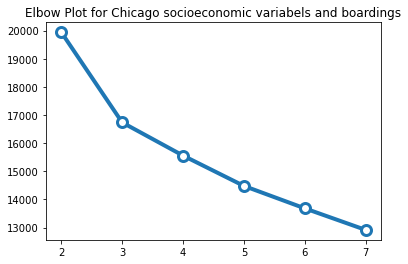

In [41]:
scaler = StandardScaler()
scaled_chicago_data = scaler.fit_transform(chicago_data_filter[['total_pop','median_income','median_rent',
                                                                'median_age','pct_college_degree','pct_racial_minorities',
                                                                'pct_property_owner','pct_commuter_PuT','DistRes','DistOffice','boardings']])

n_clusters = list(range(2, 8))

# Run kmeans for each value of k
inertias = []
for k in n_clusters:
    
    # Initialize and run
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(scaled_chicago_data)
    
    # Save the "inertia"
    inertias.append(kmeans.inertia_)
    
# Plot it!
plt.plot(n_clusters, inertias, marker='o', ms=10, mfc='white', lw=4, mew=3)
plt.title('Elbow Plot for Chicago socioeconomic variabels and boardings')

In [42]:
# Initialize the knee algorithm
kn = KneeLocator(n_clusters, inertias, curve='convex', direction='decreasing')

# Print out the knee 
print(kn.knee)

3


#### Clustering Analysis on the Map

From above, we get a sense that 3 is a good value for n. Next, we depict the clustering on the map. With a slider, the clustering on the map will change accordingly. The bar chart on the left side also shows the mean of features between each cluster with the use of the feature selection drop-down menu.

From the map, we can see the locations of the clusters if there were 3 of them. The cluster with highest boarding data (cluster number 1) also has the highest population, the highest median rent, the highest median income, the lowest median age, the highest percentage of college degree, the lowest percentage of minorities, highest percentage of public transit users, the lowest distance to residential buildings, and the lowest distance to office buildings. This shows a possible association between those socioeconomic and spatial features and ridership demand.

In [43]:
var = chicago_data_filter_GEOID.columns

# Perform the k-means fit with n from 2 to 9
n_list = [i for i in range(2, 9)]
for i in n_list:
    kmeans = KMeans(n_clusters=i, random_state=42)

    scaler = StandardScaler()
    scaled_chicago_data = scaler.fit_transform(chicago_data_filter_GEOID[var[1:]])

    kmeans.fit(scaled_chicago_data)

    label = f"label{i}"
    chicago_data_filter_GEOID[label] = kmeans.labels_
    
# merge to have geometry
chicago_cluster = chicago_data_GEOID[['GEOID', 'geometry']].merge(chicago_data_filter_GEOID, left_on='GEOID', right_on='GEOID', how='left')

In [44]:
import param as pm
var_panel = list(var[1:])
class cluster(pm.Parameterized):
    n_clusters = pm.Integer(default=2, bounds=(2, 8))
    feature = pm.Selector(default='total_pop', objects=var_panel)
    @pm.depends("n_clusters")
    def choropleth(self):
        which_label = f"label{self.n_clusters}"
        data = chicago_cluster.sort_values(by=which_label)
        return chicago_cluster.hvplot.polygons(
            c=which_label,
            cmap="Set3",
            hover_cols=[which_label],
            frame_width=600,
            frame_height=550,
            geo=True, 
            crs=3857
        )
    @pm.depends("n_clusters", "feature")
    def look_at_clusters(self):
        # calculate average feature per cluster
        which_label = f"label{self.n_clusters}"
        data = chicago_cluster.sort_values(by=which_label)
        cluster_info = chicago_data_filter_GEOID.groupby(which_label, as_index=False).mean().sort_values(by=which_label)
        return cluster_info.hvplot.bar(y=self.feature, x=which_label, c=which_label, width=300, cmap="Set3")
    
    
app = cluster(name="")
title = pn.Pane("<h1>Cluster Analysis of Chicago Bus Ridership</h1>")
panel = pn.Row(
    pn.Column(title, pn.Param(app.param, width=300), app.look_at_clusters),
    pn.Column(app.choropleth),
)

panel.servable()

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


Row
    [0] Column
        [0] Markdown(str)
        [1] Param(cluster, width=300)
        [2] ParamMethod(method)
    [1] Column
        [0] ParamMethod(method)

### Correlation
To avoid multicollinearity in the future model building process, we run a correlation test on all the selected predictors. As the Correlation Among Selected Predictors graphic shows, the variable median_income and pct_college_degree are highly correlated(0.74), therefore, we will avoid using both predictors in the same model in the further modeling process. 

Text(0.5, 1.0, 'Correlation Among Selected Predictors')

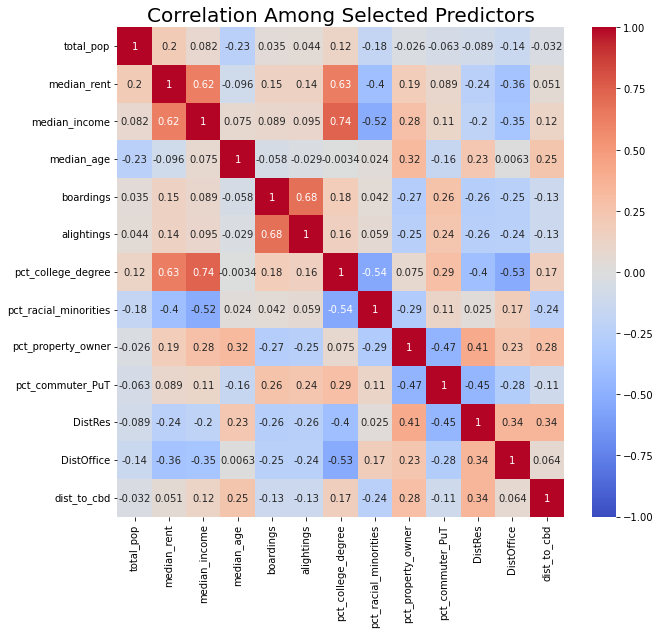

In [45]:
## check correlation
# The features
plt.figure(figsize=(10,9))
feature_cols = [col for col in chicago_data_filter]
sns.heatmap(
    chicago_data_filter[feature_cols].corr(), 
    cmap="coolwarm", 
    annot=True, 
    vmin=-1, 
    vmax=1,
)
plt.title("Correlation Among Selected Predictors", fontsize = 20) # title with fontsize 20

### OD Employment Statistics Analysis

NOTE: the size of this dataset exceed the limit for GitHub, please download through this link: https://lehd.ces.census.gov/data/lodes/LODES7/il/od/il_od_main_JT00_2019.csv.gz

We also explored the employment origin and desination (OD) patterns in Chicago to better understand whether the variables we chose are meaningful for the ridership prediction. The OD data we used is from LEHD Origin-Destination Employment Statistics (LODES) published by the US Census Bureau. We used the 2019 data in Illinois. Since there is no API for importing this data, and it is too large to be uploaded to GitHub, please click this link to download the data. We then used Dask to import this data.

In [46]:
od_df = dd.read_csv("data/il_od_main_JT00_2019.csv")
od_df

,w_geocode,h_geocode,S000,SA01,SA02,SA03,SE01,SE02,SE03,SI01,SI02,SI03,createdate
npartitions=6,,,,,,,,,,,,,
,int64,int64,int64,int64,int64,int64,int64,int64,int64,int64,int64,int64,int64
,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...,...


In [47]:
# get the length of the od df
len(od_df)

5254115

The original 2019 Illinios OD data contain 5254115 rows. Each row shows the total employment numbers (S000) of each OD pair at block level. Since all the data we have processed are in block groups, we will aggregate the employment numbers to block groups and only extract those within the City of Chicago.

In [48]:
od_df['w_geocode'] = od_df['w_geocode'].astype(str)
od_df['h_geocode'] = od_df['h_geocode'].astype(str)
od_df.head()

,w_geocode,h_geocode,S000,SA01,SA02,SA03,SE01,SE02,SE03,SI01,SI02,SI03,createdate
0,170010001001001,170010002021001,1,0,1,0,0,1,0,1,0,0,20211018
1,170010001001001,170010004003001,1,0,0,1,0,1,0,1,0,0,20211018
2,170010001001001,170010004003004,1,1,0,0,0,1,0,1,0,0,20211018
3,170010001001001,170010004003020,1,0,1,0,0,0,1,0,1,0,20211018
4,170010001001001,170010008002079,1,0,1,0,0,0,1,0,1,0,20211018


In [49]:
# get the GEOID of block groups
od_df['w_geocode'] = od_df['w_geocode'].str[:12]
od_df['h_geocode'] = od_df['h_geocode'].str[:12]
od_df.head()

,w_geocode,h_geocode,S000,SA01,SA02,SA03,SE01,SE02,SE03,SI01,SI02,SI03,createdate
0,170010001001,170010002021,1,0,1,0,0,1,0,1,0,0,20211018
1,170010001001,170010004003,1,0,0,1,0,1,0,1,0,0,20211018
2,170010001001,170010004003,1,1,0,0,0,1,0,1,0,0,20211018
3,170010001001,170010004003,1,0,1,0,0,0,1,0,1,0,20211018
4,170010001001,170010008002,1,0,1,0,0,0,1,0,1,0,20211018


In [50]:
chicago_data_GEOID = gpd.read_file('data/chicago_data_GEOID.geojson').set_crs("epsg:3857", allow_override=True,)
chicago_data_GEOID.crs

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [51]:
chicago_bg_GEOID = list(chicago_data_GEOID['GEOID'])
od_df = od_df[od_df['w_geocode'].isin(chicago_bg_GEOID)]
od_df = od_df[od_df['h_geocode'].isin(chicago_bg_GEOID)]

In [52]:
# group by w_geocode
demand = od_df.groupby(['w_geocode','h_geocode'])['S000'].sum().compute()

In [53]:
demand = demand.reset_index()
demand = demand.sort_values(["S000"], ascending = False)
demand

,w_geocode,h_geocode,S000
303610,170318391001,170318391001,841
301794,170318391001,170310818001,784
302386,170318391001,170312801001,716
302475,170318391001,170313301003,647
303611,170318391001,170318391002,541
...,...,...,...
130306,170312413001,170312515004,1
130308,170312413001,170312519004,1
130309,170312413001,170312520004,1
130310,170312413001,170312602001,1


In [54]:
w_sum = demand.groupby(["w_geocode"])["S000"].sum().reset_index()
w_sum

,w_geocode,S000
0,170310101001,4
1,170310101002,146
2,170310101003,84
3,170310102011,2
4,170310102012,30
...,...,...
2246,170318439002,14
2247,170318439003,24
2248,170318439005,6
2249,170319800001,13707


In [55]:
h_sum = demand.groupby(["h_geocode"])["S000"].sum().reset_index()
h_sum

,h_geocode,S000
0,170310101001,166
1,170310101002,561
2,170310101003,578
3,170310102011,395
4,170310102012,1074
...,...,...
2315,170318439003,212
2316,170318439004,151
2317,170318439005,231
2318,170319800001,96


In [56]:
# highest employment number for the destination 
w_GEO = w_sum[['w_geocode', 'S000']].merge(chicago_data_GEOID[["GEOID", "geometry"]], left_on='w_geocode', right_on='GEOID', how='left')
w_GEO = gpd.GeoDataFrame(w_GEO).set_crs("epsg:3857")

In [57]:
# highest employment number for the origin
h_GEO = h_sum[['h_geocode', 'S000']].merge(chicago_data_GEOID[["GEOID", "geometry"]], left_on='h_geocode', right_on='GEOID', how='left')
h_GEO = gpd.GeoDataFrame(h_GEO).set_crs("epsg:3857")

We then plotted two maps based on the number of employments in the destination block group and the number of employments from the origin block groups.

In [58]:
%%opts WMTS [width=800, height=800, xaxis=None, yaxis=None]

# number of job in each block group based on OD data (destination)
choro = w_GEO.hvplot(c='S000', 
                     width=800,
                     height=600,
                     alpha=0.8,
                     geo=True, 
                     cmap='viridis',
                     crs = 3857,
                     hover_cols=['w_geocode'],
                     title = 'Number of Destinations in Each Block Group')
gvts.ESRI * choro

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (S000,w_geocode)

In [59]:
%%opts WMTS [width=800, height=800, xaxis=None, yaxis=None]

# number of job to go to, from each block group (origin)
choro = h_GEO.hvplot(c='S000', 
                     width=800, 
                     height=600,
                     alpha=0.8,
                     geo=True, 
                     cmap="viridis",
                     crs = 3857,
                     hover_cols=['h_geocode'],
                     title = 'Number of Origins in Each Block Group')
gvts.ESRI * choro

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (S000,h_geocode)

The first map above illustrated that extremely large amount of employments are concentrated in a block in the Chicago CBD. The second map above shows that, comparing to destinations, the origin of jobs trips spread all around the city. Based on these observations we believe it is reasonable to use the distance to CBD for model building and prediction.

In our proposal, we mentioned we wanted to explore a scenerio in which if the city opens a BRT line between the block groups with the highest demand using the shortest route, what that BRT's ridership will be. We tried to proceed in that direction and plotted some block groups OD with the highest demands.

In [60]:
# get the employment destination that has the top 10 employment number
dest_bg = chicago_data_GEOID[chicago_data_GEOID['GEOID'].isin(list(demand["w_geocode"])[:10])]

In [61]:
# get the employment origin that has the top 10 employment number
origin_bg = chicago_data_GEOID[chicago_data_GEOID['GEOID'].isin(list(demand["h_geocode"])[:10])]

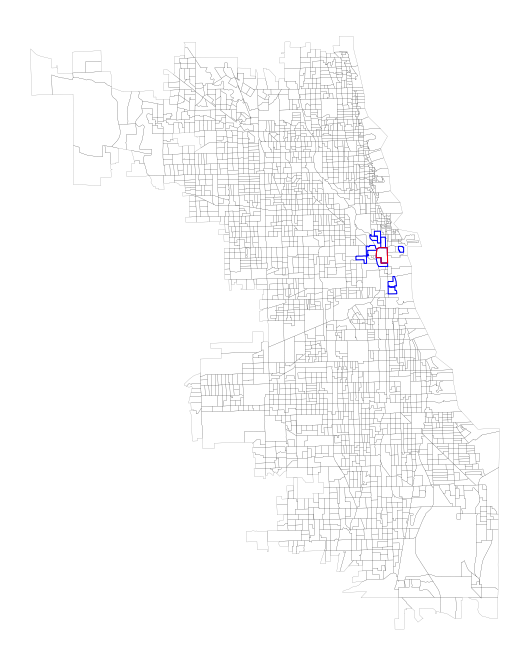

In [62]:
# plot the top 10 employment OD pair origins and destinations
# red is the desination block group, blue are the origin block groups
fig, ax = plt.subplots(figsize=(12, 12))
chicago_data_GEOID.plot(ax=ax, facecolor='none', edgecolor='black', linewidth = 0.1)
origin_bg.plot(ax=ax, facecolor='none', edgecolor='blue')
dest_bg.plot(ax=ax, facecolor='none', edgecolor='red')
ax.set_axis_off()
ax.set_aspect("equal")
plt.show()

We plotted the OD block groups which has the top 10 demand. We can see that all the top 10 ODs have the same destination block group (marked in red), which is a block group in the CBD. Although the top 10 ODs with highest demand have different origin block group, they are all very close to the destination block group geographically. Thus, it is meaningless to have a BRT line running between any of those block groups. The scenerio we imagined will not exist in real life.

## Regression and Prediction

### Training and testing on Chicago

In [63]:
chicago_data_filter = chicago_data_filter.drop(columns = ["labels", "alightings"])

# Split the data 60/40
train_set, test_set = train_test_split(chicago_data_filter, test_size = 0.4, random_state = 1)

# create the target variables
y_train = train_set["boardings"].values
y_test = test_set["boardings"].values

# The feature variables
feature_cols = [col for col in chicago_data_filter.columns if col not in ["boardings"]]
X_train = train_set[feature_cols].values
X_test = test_set[feature_cols].values

#### Linear Regression

In [64]:
# linear regression
# create a pipe to scale the data and perform linear regression
linear_pipe = make_pipeline(StandardScaler(), LinearRegression())

# fit the pipeline
print("Linear regression")
linear_pipe.fit(X_train, y_train)

# get the score on training data
training_score = linear_pipe.score(X_train, y_train)
print(f"Training Score = {training_score}")

# get the score on test data
test_score = linear_pipe.score(X_test, y_test)
print(f"Test Score = {test_score}")

Linear regression
Training Score = 0.15041047028390575
Test Score = 0.1341658937539877


#### Random Forest

In [65]:
# random forest regression
# create a pipe to scale the data and fit a random forest
forest_pipe = make_pipeline(StandardScaler(), RandomForestRegressor(random_state=1))

# find the best hyper parameter for the random forest
model_step = "randomforestregressor"
param_grid = {
    f"{model_step}__n_estimators": [5, 10, 15, 20, 30, 50, 100, 200],
    f"{model_step}__max_depth": [2, 5, 7, 9, 13, 21, 33, 51],
}

# Create the grid and use 3-fold CV
grid = GridSearchCV(forest_pipe, param_grid, cv=3)

# Run the search
grid.fit(X_train, y_train)

# get the best parameters
grid.best_params_

{'randomforestregressor__max_depth': 5,
 'randomforestregressor__n_estimators': 100}

In [66]:
# fit the model based on the hyperparameter selected
forest_pipe = make_pipeline(
    StandardScaler(), RandomForestRegressor(max_depth = 5, n_estimators = 100, random_state=1)
)

# Fit a random forest
print("Random forest")
forest_pipe.fit(X_train, y_train)

# Print the training score
training_score = forest_pipe.score(X_train, y_train)
print(f"Training Score = {training_score}")

# Print the test score
test_score = forest_pipe.score(X_test, y_test)
print(f"Test Score = {test_score}")

Random forest
Training Score = 0.45810097601783506
Test Score = 0.18079286799614014


#### Model Performance - Test on Chicago

In [67]:
# get the prediction from the best random forest model
predictions = grid.best_estimator_.predict(X_test)

In [68]:
# add the prediction result to the testset dataframe
# boardings should be integers
test_set['predictions'] = predictions.round(0)

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [69]:
# get the absolute percent err
test_set["APE"] = abs(test_set['predictions'] - test_set['boardings']).round(0)/(test_set['boardings'] + 0.1)

In [70]:
# get the geometry of test set
test_set['geometry'] = chicago_data[chicago_data.index.isin(test_set.index)]['geometry']

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\geodataframe.py:1322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


In [71]:
# set crs to test_set
test_set = gpd.GeoDataFrame(test_set).set_crs('epsg:3857')
test_set

,total_pop,median_rent,median_income,median_age,boardings,pct_college_degree,pct_racial_minorities,pct_property_owner,pct_commuter_PuT,DistRes,DistOffice,dist_to_cbd,predictions,APE,geometry
579,1605.0,1035.00000,81458.0,40.3,55.0,0.271923,0.388785,0.563700,0.166314,3461.758940,5120.755962,17093.309509,56.0,0.018149,"POLYGON ((-9769055.759 5152894.085, -9769001.5..."
1355,2612.0,1239.00000,39738.0,33.6,202.0,0.406909,0.591501,0.354680,0.425296,1754.301683,2126.576765,23367.161000,133.0,0.341415,"POLYGON ((-9761593.123 5160639.415, -9761565.9..."
47,2834.0,1247.00000,71118.0,35.1,2.0,0.128308,0.153846,0.828641,0.116513,10205.629663,4608.894057,26978.858011,21.0,9.047619,"POLYGON ((-9743980.376 5114982.237, -9743980.2..."
1118,1260.0,887.00000,54070.0,40.1,127.0,0.192073,0.226984,0.179577,0.289766,1711.475118,5222.071536,15775.579829,90.0,0.291109,"POLYGON ((-9766193.735 5152584.426, -9766165.4..."
614,940.0,786.00000,40962.0,41.9,72.0,0.302190,0.992553,0.087866,0.253886,1103.893689,2641.064312,11489.851385,94.0,0.305132,"POLYGON ((-9752803.782 5128914.884, -9752802.7..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
399,1791.0,845.00000,38750.0,31.6,43.0,0.101029,0.499162,0.431542,0.318966,4668.062270,5634.457710,20398.534672,60.0,0.394432,"POLYGON ((-9746328.772 5122804.175, -9746314.4..."
51,2419.0,1030.00000,77083.0,38.9,154.0,0.258989,0.699049,0.637786,0.229562,2469.498581,3214.213515,3510.591829,73.0,0.525633,"POLYGON ((-9758048.711 5138196.460, -9757940.8..."
771,1288.0,1290.00000,166667.0,29.5,202.0,0.677983,0.221273,0.398017,0.569565,941.289047,3079.874695,15142.545086,129.0,0.361207,"POLYGON ((-9757610.446 5151982.798, -9757593.8..."
640,1025.0,1145.33871,62391.0,51.9,84.0,0.122744,0.096585,0.828205,0.214403,7110.982773,5132.571911,18500.874784,41.0,0.511296,"POLYGON ((-9773507.871 5151717.615, -9773480.7..."


In [72]:
test_set2= test_set.to_crs(epsg=4326)
test_set2.hvplot(c='APE', 
                     frame_width=600, 
                     frame_height=500, 
                     geo=True, 
                     cmap='gnuplot2', 
                     hover_cols=['boardings','predictions','APE'],
                     title='Average Percent Error at Block Group Level')

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


:Polygons   [Longitude,Latitude]   (APE,boardings,predictions)

The first step of this regression process is analyzing if there is a linear correlation between the number of boardings and other socioeconomic predictors. However, the result of the linear regression turned out to be relatively weak. The score on the training set is about 0.15, and the score on the test set is around 0.13. Therefore, we think the correlation between the boardings and our selected predictors is not simply linearly correlated. 
To predict the bus ridership, we used another supervised learning algorithm - the random forest regression, which combines predictions from multiple machine learning algorithms and can be a more accurate prediction than a single model. As our random forest result shows, the score on the training set is around 0.46, and the score on the test set is about 0.18, which is much improved than the scores from linear regression.
To understand the error between our predicted boardings and actual boardings at the spatial level, we calculated the average percent error for each block group and used hvplot to visualize the results. As the Average Percent Error at Block Group Level plot shows, the large errors (in blue color) occur on the edge of the city. If we hover over these blocks with these errors, we will find that all these block groups do not have any boarding records, but our model predicted some boardings for these block groups. Also highlighted in red is a block group near the city's center. Our data show that this block group has no boarding, but our random forest model assigned it 182 boardings. A possible explanation for such error is that this block group is too small that no bus stop locates within it. Meanwhile, this block group clustered with other high boardings block groups based on the socioeconomic predictors. Therefore, the boardings for this block group is 0. 

### Predict on Philadelphia

In [73]:
philly_data_filter = philly_data_filter.drop(columns = ["GEOID"])

In [74]:
philly_data_filter.head()

,total_pop,median_rent,median_income,median_age,pct_college_degree,pct_racial_minorities,pct_property_owner,pct_commuter_PuT,DistRes,DistOffice,dist_to_cbd
0,1970.0,1187.0,69671.596558,19.6,0.551724,0.285279,0.028881,0.293103,218.506743,1962.775024,2857.122555
1,1290.0,1143.0,47926.000000,27.9,0.060719,0.719380,0.686813,0.084034,4387.035207,7775.447155,9303.483359
2,1029.0,1100.0,48636.000000,39.0,0.171348,0.081633,0.486804,0.137255,3729.283551,7401.675139,8264.259537
3,455.0,983.0,106094.000000,25.3,0.848485,0.162637,0.245455,0.412371,495.506816,2342.482803,3083.761064
4,2273.0,1288.0,69671.596558,19.3,0.562500,0.371755,0.042373,0.261538,204.986683,2121.170161,2934.934663


In [75]:
# get the prediction from the best random forest model
philly_predictions = grid.best_estimator_.predict(philly_data_filter)

In [76]:
# add the prediction result to the philly df
# boardings should be integers
philly_data['predictions'] = philly_predictions.round(0)

In [77]:
# map the predictions
# convert dataset to crs: 4326
philly_data_plot= philly_data.to_crs(epsg=4326)

philly_data_plot.hvplot(c='predictions', 
                     frame_width=600, 
                     frame_height=500, 
                     geo=True, 
                     cmap='viridis', 
                     hover_cols=['GEOID','predictions'],
                     title='Predicted Bus Ridership in Philadelphia')

C:\Users\fiona\miniconda3\envs\musa-550-fall-2021\lib\site-packages\geopandas\_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out


:Polygons   [Longitude,Latitude]   (predictions,GEOID)

In [78]:
philly_data.head(3)

,GEOID,geometry,NAME,total_pop,median_rent,median_income,median_age,educational_attainment_pop25,bachelor_degree,master_degree,...,tract,block group,pct_college_degree,pct_racial_minorities,pct_property_owner,pct_commuter_PuT,DistRes,DistOffice,dist_to_cbd,predictions
0,421010090004,"POLYGON ((-8370567.253 4859618.633, -8370565.4...","Block Group 4, Census Tract 90, Philadelphia C...",1970.0,1187.0,69671.596558,19.6,232.0,36.0,92.0,...,9000.0,4.0,0.551724,0.285279,0.028881,0.293103,218.506743,1962.775024,2857.122555,96.0
1,421010188002,"POLYGON ((-8360576.329 4865634.793, -8360515.3...","Block Group 2, Census Tract 188, Philadelphia ...",1290.0,1143.0,47926.000000,27.9,807.0,33.0,16.0,...,18800.0,2.0,0.060719,0.719380,0.686813,0.084034,4387.035207,7775.447155,9303.483359,39.0
2,421010382002,"POLYGON ((-8360910.732 4864437.488, -8360638.5...","Block Group 2, Census Tract 382, Philadelphia ...",1029.0,1100.0,48636.000000,39.0,712.0,98.0,19.0,...,38200.0,2.0,0.171348,0.081633,0.486804,0.137255,3729.283551,7401.675139,8264.259537,45.0


In [79]:
chicago_data_filter.head(3)

,total_pop,median_rent,median_income,median_age,boardings,pct_college_degree,pct_racial_minorities,pct_property_owner,pct_commuter_PuT,DistRes,DistOffice,dist_to_cbd
0,1560.0,800.0,36250.0,28.7,165.0,0.109321,0.455128,0.372032,0.216612,4920.242486,4925.627689,4254.880809
1,1178.0,796.0,29643.0,25.4,10.0,0.043406,0.425297,0.223776,0.116402,5032.392357,4704.293453,4386.418475
2,2018.0,1628.0,159205.0,38.8,160.0,0.630701,0.174430,0.510791,0.457009,1447.692167,3316.507070,13219.823862


## Use Case Scenario

As students in Philadelphia, our group wonders about the bus ridership pattern in Philadelphia. However, after searching online, we realized that SEPTA does not have any publicized bus ridership data. To better understand the bus ridership demand and the further developed bus services in underserved areas in Philadephia, we applied the model established based on the Chicago bus ridership dataset to Philadelphia since these two cities are relatively equivalent in size and socioeconomic conditions. The map above shows our predicted bus ridership for each block group in Philadelphia. As the plot above shows, block groups in Center City and the University City tend to have higher bus ridership based on the model. Both areas have high concentrations of students and employees with higher bus demand. Such prediction can later help SEPTA with deciding which blcok group need more bus service or helping with making decision on new bus routes. 

In [80]:
def init_map(lat=39.99, long=-75.13, zoom_start=11):
    return fm.Map(location=[lat,long], zoom_start=zoom_start)

In [81]:
data_test = philly_data.to_crs(epsg=4326)
bus_ridership = philly_stops.to_crs(epsg=4326)

In [82]:
## choropleth for predictions
def choose_x(x='predictions'):    
    # Minimum
    min_val = data_test[x].min()

    # Maximum
    max_val = data_test[x].max()

    # Calculate a normalized column
    normalized = (data_test[x] - min_val) / (max_val - min_val)

    # Add to the dataframe
    data_test["normalized"] = normalized
 
# Use a red-purple colorbrewer color scheme
cmap = plt.get_cmap('PuBu')

def get_style(feature):
    # Get the data value from the feature
    value = feature['properties']['normalized']

    # Evaluate the color map
    # NOTE: value must between 0 and 1
    rgb_color = cmap(value) # this is an RGB tuple

    # Convert to hex string
    color = mcolors.rgb2hex(rgb_color)

    # Return the style dictionary
    return {'weight': 0.5, 'color': color, 'fillColor': color, "fillOpacity": 0.75}

def get_highlighted_style(feature):
    return {"weight": 3, "color": "black"}
    

In [83]:
columns = list(data_test.columns[3:])
columns.remove('GEO_ID')
columns.remove('state')
columns.remove('county')
columns.remove('tract')
columns.remove('block group')


class PanelFoliumMap(param.Parameterized):
    feature = param.Selector(default="predictions", objects=columns)

    def __init__(self, max_records=2500, name=""):
        super().__init__(name=name)

        TOR_COORDINATES = (
            pd.to_numeric(bus_ridership["stop_lat"]).mean(),
            pd.to_numeric(bus_ridership["stop_lon"]).mean(),
        )

        # subset to match subset of locations
        self.mc = MarkerCluster()

        # iterate through dataset to create clusters
        for row in bus_ridership[0:max_records].itertuples():
            self.mc.add_child(
                fm.Marker(location=[row.stop_lat, row.stop_lon], 
                          #popup=row.predictions
                         )
            )
            
    # Set default choropleth column
    choose_x()

    @param.depends("feature")
    def get_map(self):

        # Get new map
        self.map = init_map()
        
        # Add markercluster
        self.map.add_child(self.mc)
        
        # Set choropleth column
        choose_x(self.feature)


        # Add the GeoJson to the map
        folium.GeoJson(
            data_test[
                ["geometry", "normalized", self.feature]
            ].to_json(),  # IMPORTANT: make sure CRS is lat/lng (EPSG=4326)
            style_function=get_style,
            tooltip=folium.GeoJsonTooltip([self.feature]),
        ).add_to(self.map)

        return pn.Pane(self.map, width=1000, height=500)

In [84]:
app = PanelFoliumMap(name="")

In [85]:
# The title
title = pn.Pane("<h1>Predicted Bus Ridership in Philadelphia by Block Group</h1>", width=1000)
# Layout the dashboard
panel = pn.Column(
    pn.Row(title),
    pn.Row(pn.Column(app.param.feature, app.get_map)),
)
panel.servable()

Column
    [0] Row
        [0] Markdown(str, width=1000)
    [1] Row
        [0] Column
            [0] Select(name='Feature', options=OrderedDict([('total_pop',...]), value='predictions')
            [1] ParamMethod(method)

## Conclusion
Through this project, we aimed to use the existing Chicago bus ridership data, the O-D employment statistics, socioeconomic data from census' 2015-2019 American Community Survey, and spatial features from OpenStreetMap to build a model for predicting bus ridership for cities without open bus ridership data. In this project, we chose Philadelphia as the scenario city. After collecting all the necessary datasets, we created several dashboards to visualize the distribution and scatter plots for selected socioeconomic predictors and created a heatmap dashboard to visualize the bus ridership hotspots in Chicago. 

We tried both linear and random forest regressions on the Chicago dataset to identify the best model. Our test results show that random forest outperforms linear regression. As a result, we chose the best random forest model to forecast bus ridership in Philadelphia. We also made an error plot for Chicago to visualize the predicting errors geographically. Our dashboard indicates that block groups on the outskirts have higher error rates.

We can't evaluate the accuracy of our predictions for Philadelphia because SEPTA's bus ridership data is missing. However, based on socioeconomic characteristics such as population, we could tell from the dashboard that the model predicted ridership reasonably well. The Center City area, for example, as students from Philadelphia, we know that this area should has a relatively high ridership.

Currently, our research is primarily focused on socioeconomic and spatial variables. However, predicting bus ridership is a very complicated analysis. To improve our model further, we should include temporal indicators such as weather and temperature. Furthermore, deciding a new bus route cannot be based solely on the model. Other factors to consider include topography, existing road systems, funding, and equity.
